In [1]:
!pip install -r requirements.txt

In [2]:
!pip install daal==2021.4.0

  Using cached daal-2021.4.0-py2.py3-none-win_amd64.whl (69.0 MB)
  Using cached tbb-2021.10.0-py3-none-win_amd64.whl (284 kB)
  Attempting uninstall: tbb
    Found existing installation: TBB 0.2


ERROR: Cannot uninstall 'TBB'. It is a distutils installed project and thus we cannot accurately determine which files belong to it which would lead to only a partial uninstall.


In [3]:
!pip show numpy

Name: numpy
Version: 1.23.2
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: BSD
Location: c:\users\pakale\anaconda3\lib\site-packages
Requires: 
Required-by: astropy, bkcharts, bokeh, Bottleneck, daal4py, datashader, datashape, gensim, h5py, holoviews, hvplot, imagecodecs, ImageHash, imageio, matplotlib, mkl-fft, mkl-random, numba, numexpr, openai, pandas, patsy, phik, pyerfa, PyWavelets, scikit-image, scikit-learn, scipy, seaborn, sentence-transformers, statsmodels, tables, tifffile, torchvision, transformers, visions, wordcloud, xarray, ydata-profiling


In [4]:
!pip install pandas-profiling

In [5]:
!pip install matplotlib
!pip install wordcloud
!pip install nltk

In [ ]:
#!pip install llvmlite --ignore-installed
#!pip install omniplot
#import omniplot.plot as op

In [1]:
import os
import json
import torch
import warnings
import string

import pandas as pd
import numpy as nm
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.express as px

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

nltk.download('stopwords') # Download the stopwords corpus
nltk.download('punkt') # Download the punkt tokenizer

from collections import Counter

from wordcloud import WordCloud

from pandas_profiling import ProfileReport

from tqdm import tqdm
from PIL import Image
from transformers import VisionEncoderDecoderModel, ViTFeatureExtractor, AutoTokenizer

warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\pakale\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\pakale\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
C:\Users\pakale\Anaconda3\lib\site-packages\numba\core\decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
C:\Users\pakale\Anaconda3\lib\site-packages\visions\backends\shared\nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://nu

In [2]:
input_path = "data"

In [3]:
problems = json.load(open(os.path.join(input_path, 'problems.json')))

In [4]:
problems_with_pids = []

for pid in list(problems.keys()):
    problem = problems[pid]
    problem['pid'] = pid
    problems_with_pids.append(problem)
    
## problems_with_pids

In [5]:
df_problems = pd.DataFrame(problems_with_pids)

In [6]:
df_problems.head()

,question,choices,answer,hint,image,task,grade,subject,topic,category,skill,lecture,solution,split,pid
0,Which of these states is farthest north?,"[West Virginia, Louisiana, Arizona, Oklahoma]",0,,image.png,closed choice,grade2,social science,geography,Geography,Read a map: cardinal directions,"Maps have four cardinal directions, or main di...","To find the answer, look at the compass rose. ...",train,1
1,Identify the question that Tom and Justin's ex...,[Do ping pong balls stop rolling along the gro...,1,The passage below describes an experiment. Rea...,image.png,closed choice,grade8,natural science,science-and-engineering-practices,Designing experiments,Identify the experimental question,Experiments can be designed to answer specific...,,train,2
2,Identify the question that Kathleen and Bryant...,[Does Kathleen's snowboard slide down a hill i...,0,The passage below describes an experiment. Rea...,image.png,closed choice,grade7,natural science,science-and-engineering-practices,Designing experiments,Identify the experimental question,Experiments can be designed to answer specific...,,train,3
3,Which figure of speech is used in this text?\n...,"[chiasmus, apostrophe]",1,,None,closed choice,grade11,language science,figurative-language,Literary devices,"Classify the figure of speech: anaphora, antit...",Figures of speech are words or phrases that us...,"The text uses apostrophe, a direct address to ...",test,4
4,Which of the following could Gordon's test show?,[if the spacecraft was damaged when using a pa...,1,People can use the engineering-design process ...,image.png,closed choice,grade8,natural science,science-and-engineering-practices,Engineering practices,Evaluate tests of engineering-design solutions,People can use the engineering-design process ...,,test,5


In [7]:
df_problems.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21208 entries, 0 to 21207
Data columns (total 15 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   question  21208 non-null  object
 1   choices   21208 non-null  object
 2   answer    21208 non-null  int64 
 3   hint      21208 non-null  object
 4   image     10332 non-null  object
 5   task      21208 non-null  object
 6   grade     21208 non-null  object
 7   subject   21208 non-null  object
 8   topic     21208 non-null  object
 9   category  21208 non-null  object
 10  skill     21208 non-null  object
 11  lecture   21208 non-null  object
 12  solution  21208 non-null  object
 13  split     21208 non-null  object
 14  pid       21208 non-null  object
dtypes: int64(1), object(14)
memory usage: 2.4+ MB


### Out of 21208 questions, 10332 questions have images

In [8]:
# Convert variables to categorical variables
df_problems[['task', 'grade', 'subject', 'topic', 'category', 'skill']] = df_problems[['task', 'grade', 'subject', 'topic', 'category', 'skill']].astype('category')

In [9]:
df_problems.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21208 entries, 0 to 21207
Data columns (total 15 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   question  21208 non-null  object  
 1   choices   21208 non-null  object  
 2   answer    21208 non-null  int64   
 3   hint      21208 non-null  object  
 4   image     10332 non-null  object  
 5   task      21208 non-null  category
 6   grade     21208 non-null  category
 7   subject   21208 non-null  category
 8   topic     21208 non-null  category
 9   category  21208 non-null  category
 10  skill     21208 non-null  category
 11  lecture   21208 non-null  object  
 12  solution  21208 non-null  object  
 13  split     21208 non-null  object  
 14  pid       21208 non-null  object  
dtypes: category(6), int64(1), object(8)
memory usage: 1.6+ MB


In [16]:
profile = ProfileReport(df_problems, title="ScienceQA Raw Data Summary")
profile.to_notebook_iframe()
profile.to_file('profile_report/science_data_report.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
# Preprocess the text data
def preprocess_text(text):
    # Convert the text to lowercase
    text = text.lower()
    # Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))
    # Tokenize the text
    tokens = word_tokenize(text)
    # Remove stopwords
    stop_words = stopwords.words('english')
    tokens = [token for token in tokens if token not in stop_words]
    # Join the tokens back into a string
    text = ' '.join(tokens)
    return text

# Generate a word frequency distribution
def generate_word_frequency(pd_series):
    word_freq = Counter()
    for text in pd_series:
        word_freq.update(text.split())
    return word_freq

# Plot word count
def plot_word_count(word_freq):
    # Generate a word cloud
    wordcloud = WordCloud(width=800, height=800, background_color='white').generate_from_frequencies(word_freq)

    # Plot the word cloud
    plt.figure(figsize=(4, 4), facecolor=None)
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=0)

    plt.show()
    
    

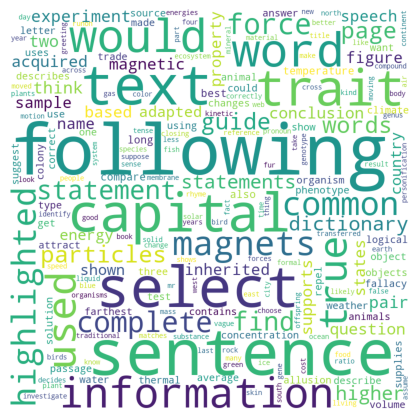

In [16]:
## Create word cloud for "question"

# Apply the preprocess_text function to the Dialogue column
df_problems['question_after_prepocessing'] = df_problems['question'].apply(preprocess_text)
# Generate a word frequency distribution
word_freq = generate_word_frequency(df_problems['question_after_prepocessing'])
# Plot word count
plot_word_count(word_freq)

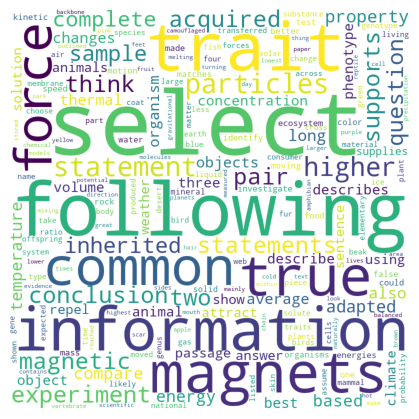

In [17]:
## Create word cloud for "Question=natural science"

science = pd.DataFrame()
science['natural_science'] = df_problems[df_problems.subject=='natural science']['question']
# Apply the preprocess_text function to the Dialogue column
science['natural_science'] = science['natural_science'].apply(preprocess_text)
# Generate a word frequency distribution
word_freq = generate_word_frequency(science['natural_science'])
# Plot word count
plot_word_count(word_freq)

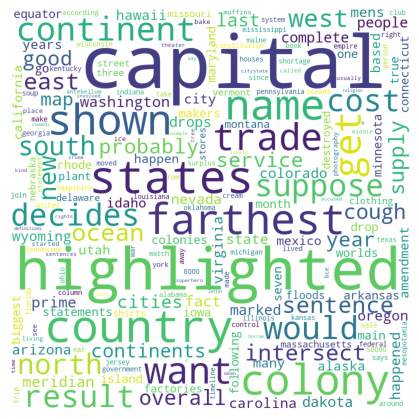

In [18]:
## Create word cloud for "Question=social science"

science = pd.DataFrame()
science['social_science'] = df_problems[df_problems.subject=='social science']['question']
# Apply the preprocess_text function to the Dialogue column
science['social_science'] = science['social_science'].apply(preprocess_text)
# Generate a word frequency distribution
word_freq = generate_word_frequency(science['social_science'])
# Plot word count
plot_word_count(word_freq)

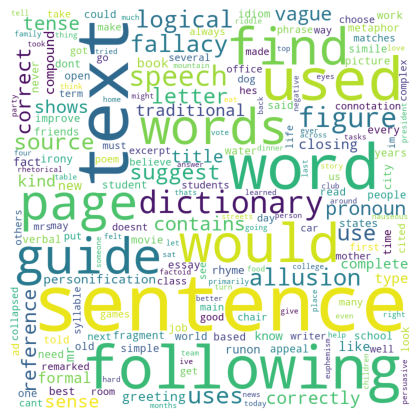

In [19]:
## Create word cloud for "Question=language science"

science = pd.DataFrame()
science['natural_science'] = df_problems[df_problems.subject=='language science']['question']
# Apply the preprocess_text function to the Dialogue column
science['natural_science'] = science['natural_science'].apply(preprocess_text)
# Generate a word frequency distribution
word_freq = generate_word_frequency(science['natural_science'])
# Plot word count
plot_word_count(word_freq)

natural science     11487
language science     5371
social science       4350
Name: subject, dtype: int64


<AxesSubplot:ylabel='subject'>

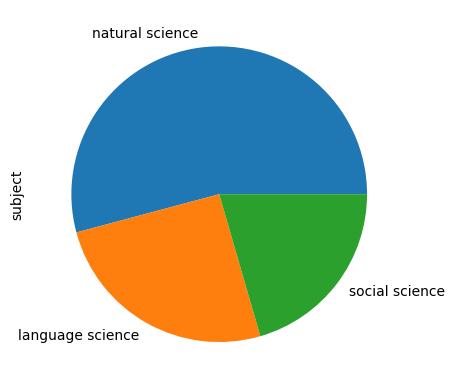

In [15]:
## subject wise question distribution
print(df_problems.subject.value_counts())
df_problems.subject.value_counts().plot(kind='pie')

grade4     3544
grade5     3086
grade3     3032
grade7     2749
grade8     2546
grade6     2450
grade2     1678
grade10     558
grade11     539
grade9      491
grade12     440
grade1       95
Name: grade, dtype: int64


<AxesSubplot:ylabel='grade'>

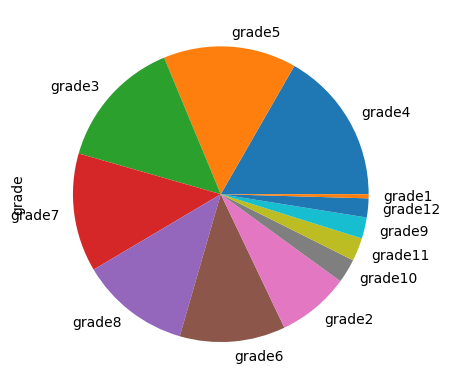

In [16]:
## Grade wise question distribution
print(df_problems.grade.value_counts())
df_problems.grade.value_counts().plot(kind='pie')

biology                              4098
physics                              3215
geography                            2956
writing-strategies                   1650
figurative-language                  1260
chemistry                            1194
earth-science                        1152
science-and-engineering-practices     924
units-and-measurement                 870
reference-skills                      724
economics                             682
punctuation                           514
us-history                            510
grammar                               379
verbs                                 251
capitalization                        198
vocabulary                            162
civics                                126
phonological-awareness                 97
reading-comprehension                  84
world-history                          65
word-study                             39
literacy-in-science                    34
pronouns                          

<AxesSubplot:ylabel='topic'>

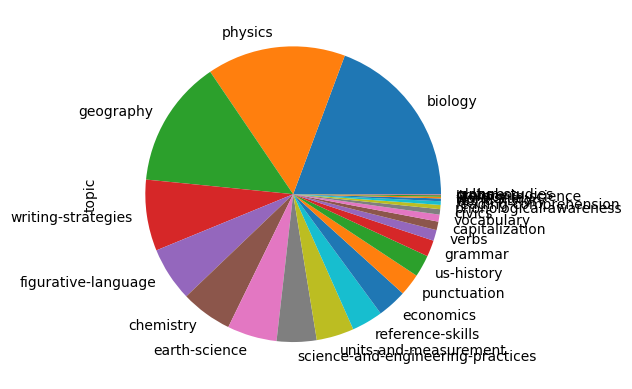

In [17]:
## topic wise question distribution
print(df_problems.topic.value_counts())
df_problems.topic.value_counts().plot(kind='pie')

In [10]:
# plot question distribution
def create_tokens(question):
    # Convert the text to lowercase
    question = question.strip().lower()
    # Remove punctuation
    question = question.translate(str.maketrans('', '', string.punctuation))
    # Tokenize the text
    tokens = word_tokenize(question)
    return tokens

In [11]:
question_distribution = pd.DataFrame(columns=['word1','word2','word3'])

for question in df_problems['question']:
    tokens = create_tokens(question)
    tokens_dict = {'word1':tokens[0], 'word2':tokens[1], 'word3':tokens[2]}
    question_distribution = question_distribution.append(tokens_dict, ignore_index = True)

In [12]:
question_distribution.head()

,word1,word2,word3
0,which,of,these
1,identify,the,question
2,identify,the,question
3,which,figure,of
4,which,of,the


In [13]:
# Plot distribution of first 3 words in questions
fig = px.sunburst(question_distribution,
                  path = ['word1', 'word2', 'word3'], width=800, height=800)

fig.show()

In [14]:
# Convert categorical variables to str
df_sub_top_cat_skill = pd.DataFrame()
df_sub_top_cat_skill[['subject', 'topic', 'category', 'skill']] = df_problems[['subject', 'topic', 'category', 'skill']].astype(str)

# Plot distribution of subject, topic, categories, skill
fig = px.sunburst(df_sub_top_cat_skill,
                  path = ['subject', 'topic', 'category', 'skill'], width=1000, height=1000)

fig.show()